<a href="https://colab.research.google.com/github/yousseflashin/Product_sales_prediction/blob/main/AI_Prediction_For_Sales_and_inventory_Managment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import sklearn

In [2]:
data_set=pd.read_csv("/content/retail_data.csv")
data_set.head()

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,...,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,Ebony39@gmail.com,1.414787e+09,3959 Amanda Burgs,Dortmund,Berlin,77985.0,Germany,...,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5.0,Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,Mark36@gmail.com,6.852900e+09,82072 Dawn Centers,Nottingham,England,99071.0,UK,...,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4.0,Lenovo Tab
2,6679610.0,30192.0,Scott Jensen,Shane85@gmail.com,8.362160e+09,4133 Young Canyon,Geelong,New South Wales,75929.0,Australia,...,1063.432799,Books,Penguin Books,Children's,Average,Same-Day,Credit Card,Processing,2.0,Sports equipment
3,7232460.0,62101.0,Joseph Miller,Mary34@gmail.com,2.776752e+09,8148 Thomas Creek Suite 100,Edmonton,Ontario,88420.0,Canada,...,2466.854021,Home Decor,Home Depot,Tools,Excellent,Standard,PayPal,Processing,4.0,Utility knife
4,4983775.0,27901.0,Debra Coleman,Charles30@gmail.com,9.098268e+09,5813 Lori Ports Suite 269,Bristol,England,48704.0,UK,...,248.553049,Grocery,Nestle,Chocolate,Bad,Standard,Cash,Shipped,1.0,Chocolate cookies


In [11]:
data_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 302010 entries, 0 to 302009
Data columns (total 20 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Transaction_ID    301677 non-null  float64
 1   Customer_ID       301702 non-null  float64
 2   Name              301628 non-null  object 
 3   Age               301837 non-null  float64
 4   Gender            301693 non-null  object 
 5   Income            301720 non-null  object 
 6   Customer_Segment  301795 non-null  object 
 7   Date              301651 non-null  object 
 8   Year              301660 non-null  float64
 9   Month             301737 non-null  object 
 10  Time              301660 non-null  object 
 11  Total_Purchases   301649 non-null  float64
 12  Amount            301653 non-null  float64
 13  Total_Amount      301660 non-null  float64
 14  Product_Category  301727 non-null  object 
 15  Product_Brand     301729 non-null  object 
 16  Product_Type      30

In [3]:
data_set=data_set.drop(columns=['Email','Phone','Address','City','State','Zipcode','Country','Shipping_Method','Payment_Method','Order_Status'])
data_set.head()

,Transaction_ID,Customer_ID,Name,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,21.0,Male,Low,Regular,9/18/2023,2023.0,September,22:03:55,3.0,108.028757,324.086270,Clothing,Nike,Shorts,Excellent,5.0,Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,19.0,Female,Low,Premium,12/31/2023,2023.0,December,8:42:04,2.0,403.353907,806.707815,Electronics,Samsung,Tablet,Excellent,4.0,Lenovo Tab
2,6679610.0,30192.0,Scott Jensen,48.0,Male,Low,Regular,4/26/2023,2023.0,April,4:06:29,3.0,354.477600,1063.432799,Books,Penguin Books,Children's,Average,2.0,Sports equipment
3,7232460.0,62101.0,Joseph Miller,56.0,Male,High,Premium,05-08-23,2023.0,May,14:55:17,7.0,352.407717,2466.854021,Home Decor,Home Depot,Tools,Excellent,4.0,Utility knife
4,4983775.0,27901.0,Debra Coleman,22.0,Male,Low,Premium,01-10-24,2024.0,January,16:54:07,2.0,124.276524,248.553049,Grocery,Nestle,Chocolate,Bad,1.0,Chocolate cookies


In [4]:
data_set['products']=data_set['Product_Brand']+' '+data_set['products']
data_set.head()

,Transaction_ID,Customer_ID,Name,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,21.0,Male,Low,Regular,9/18/2023,2023.0,September,22:03:55,3.0,108.028757,324.086270,Clothing,Nike,Shorts,Excellent,5.0,Nike Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,19.0,Female,Low,Premium,12/31/2023,2023.0,December,8:42:04,2.0,403.353907,806.707815,Electronics,Samsung,Tablet,Excellent,4.0,Samsung Lenovo Tab
2,6679610.0,30192.0,Scott Jensen,48.0,Male,Low,Regular,4/26/2023,2023.0,April,4:06:29,3.0,354.477600,1063.432799,Books,Penguin Books,Children's,Average,2.0,Penguin Books Sports equipment
3,7232460.0,62101.0,Joseph Miller,56.0,Male,High,Premium,05-08-23,2023.0,May,14:55:17,7.0,352.407717,2466.854021,Home Decor,Home Depot,Tools,Excellent,4.0,Home Depot Utility knife
4,4983775.0,27901.0,Debra Coleman,22.0,Male,Low,Premium,01-10-24,2024.0,January,16:54:07,2.0,124.276524,248.553049,Grocery,Nestle,Chocolate,Bad,1.0,Nestle Chocolate cookies


In [5]:
grouped_df = data_set.groupby(['Year', 'Month', 'products']).agg({'Total_Purchases': 'sum'}).reset_index()
print(grouped_df)

        Year      Month                  products  Total_Purchases
0     2023.0      April             Adidas Blazer            347.0
1     2023.0      April      Adidas Bomber jacket            357.0
2     2023.0      April              Adidas Boots            303.0
3     2023.0      April      Adidas Crew neck tee            391.0
4     2023.0      April           Adidas Crop top            279.0
...      ...        ...                       ...              ...
8210  2024.0  September            Samsung iPhone              3.0
8211  2024.0  September             Sony Huawei P              6.0
8212  2024.0  September  Sony Over-ear headphones              8.0
8213  2024.0  September               Zara Blouse             10.0
8214  2024.0  September        Zara Flannel shirt              7.0

[8215 rows x 4 columns]


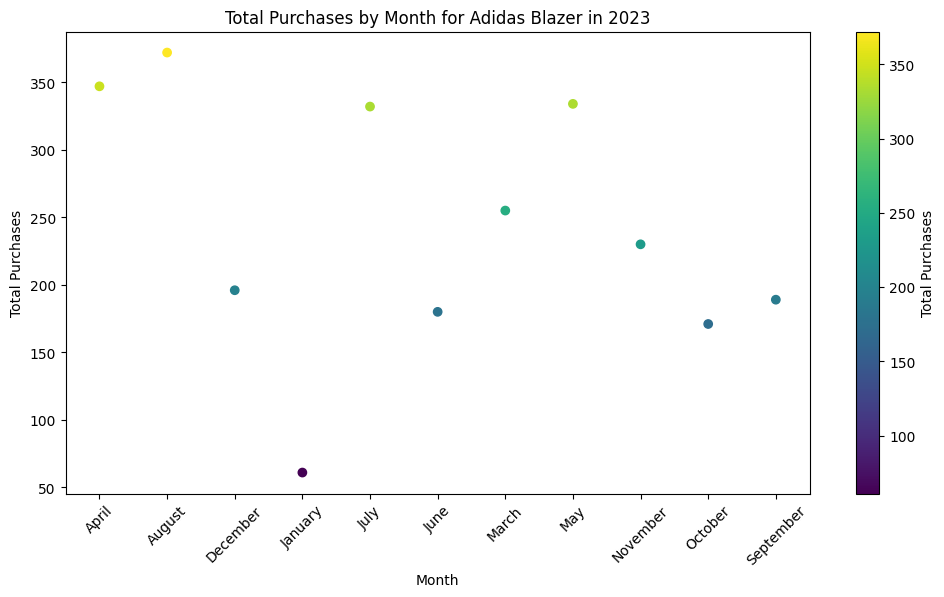

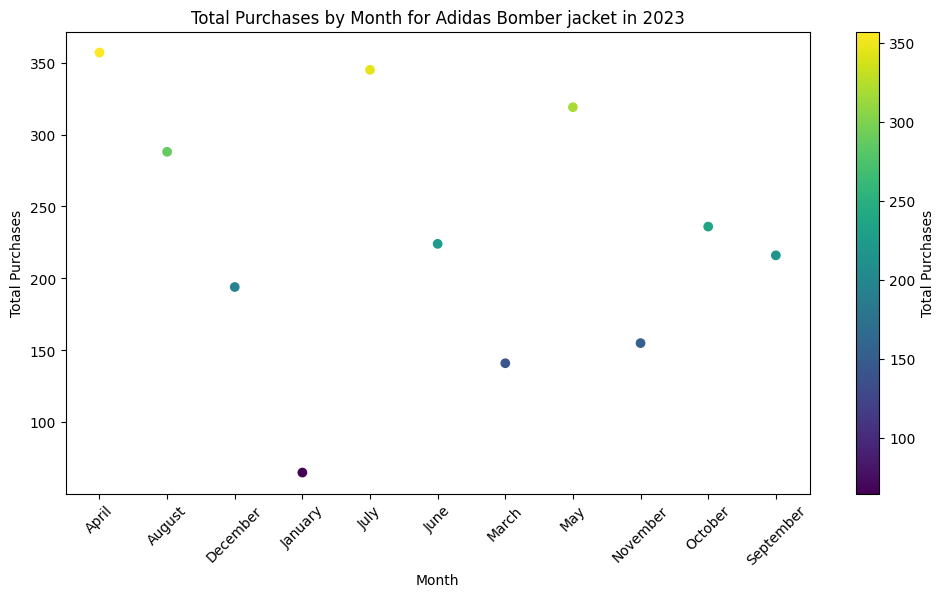

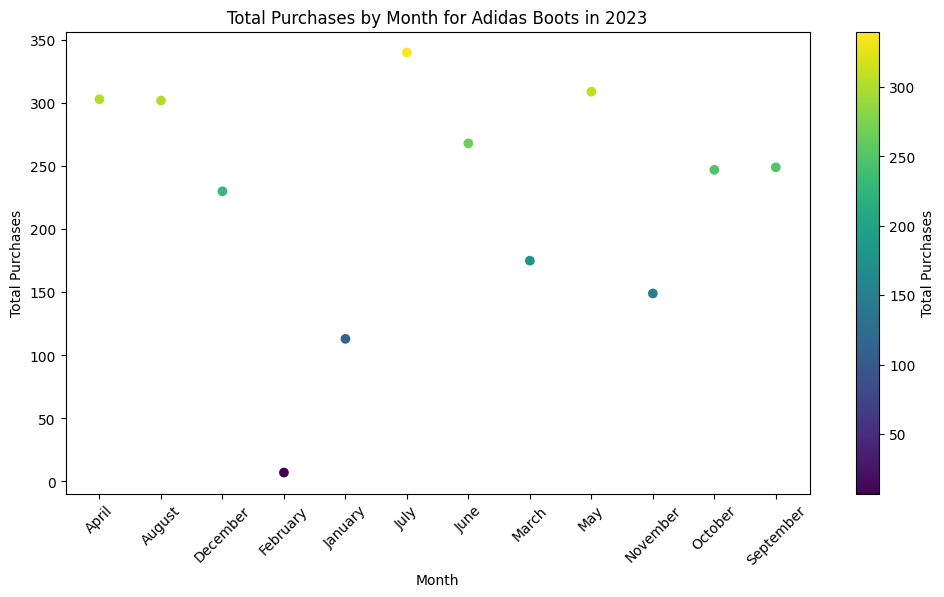

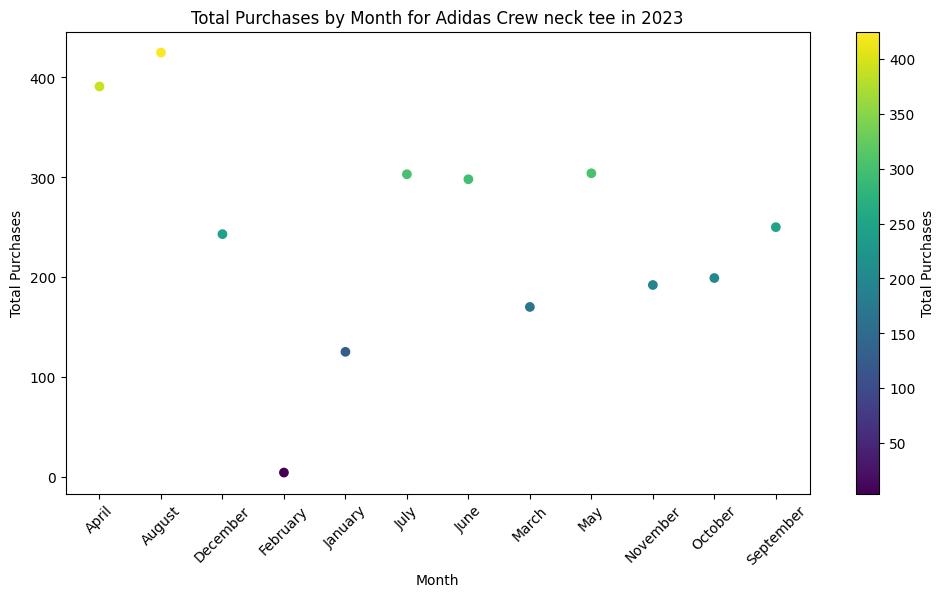

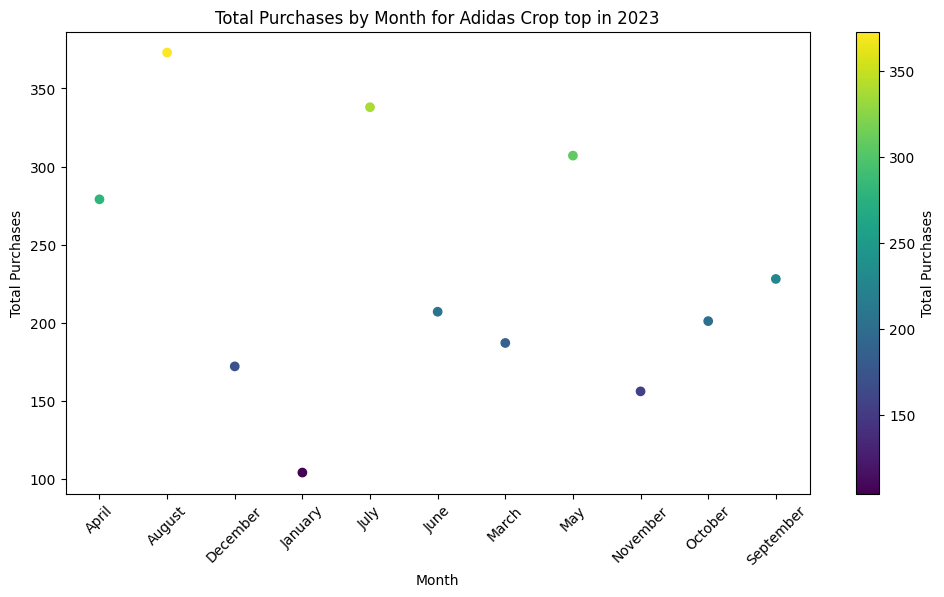

...

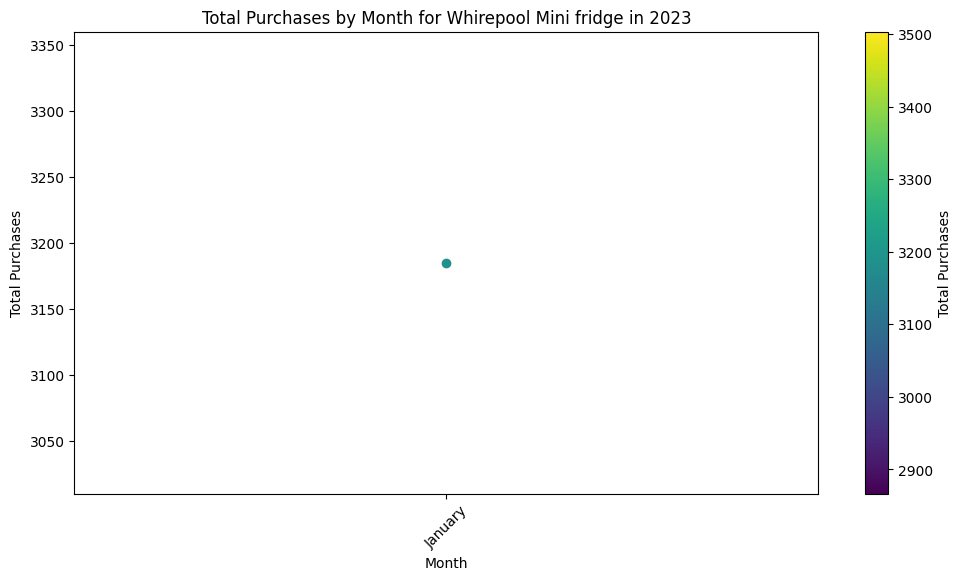

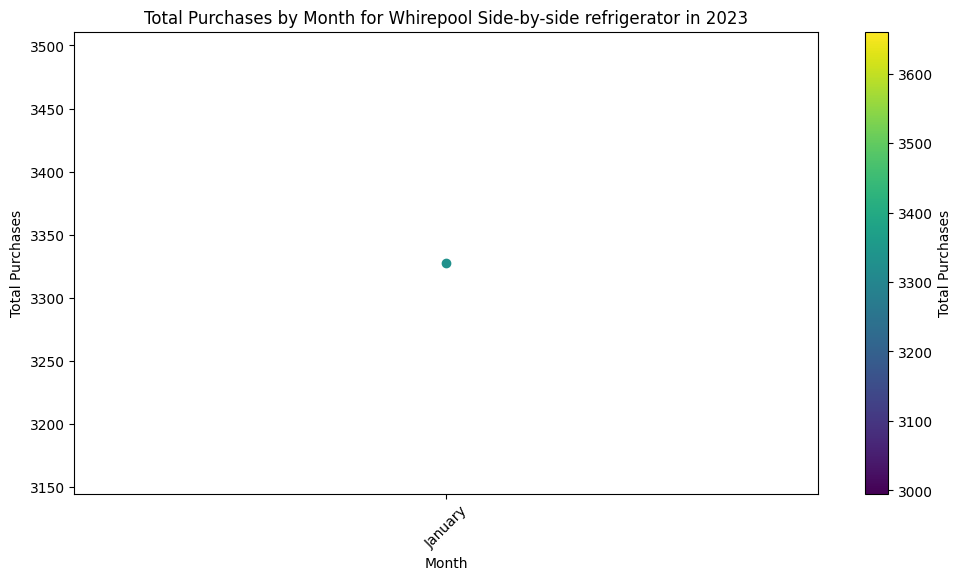

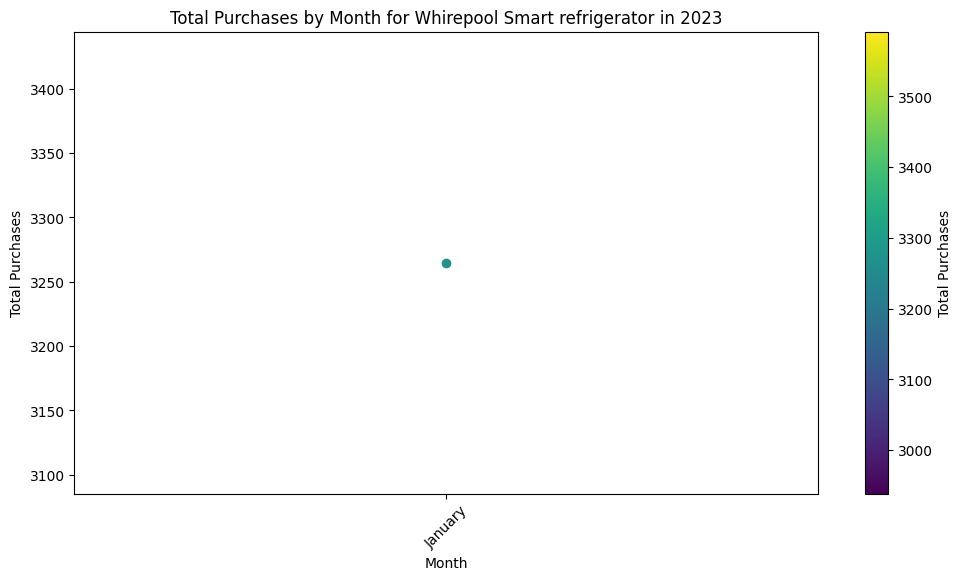

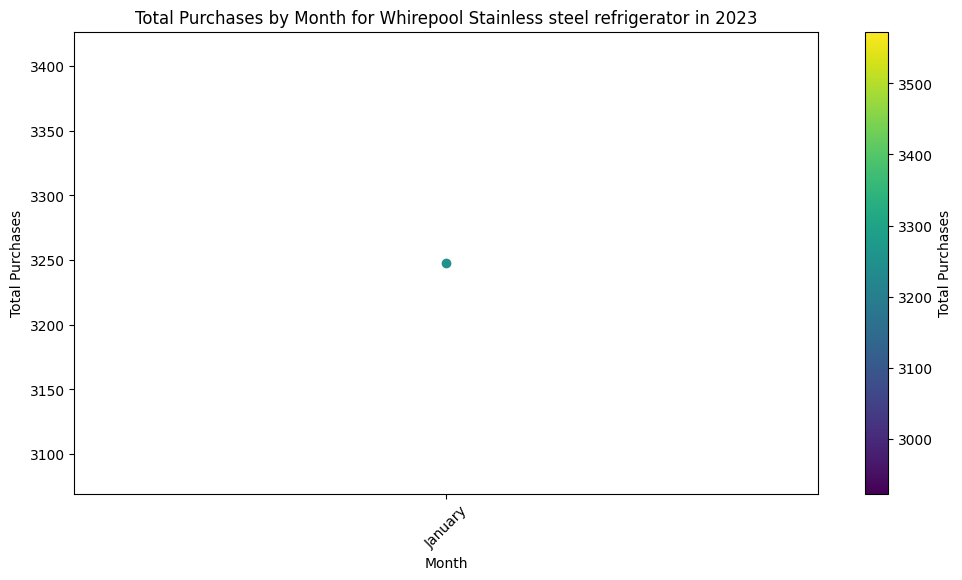

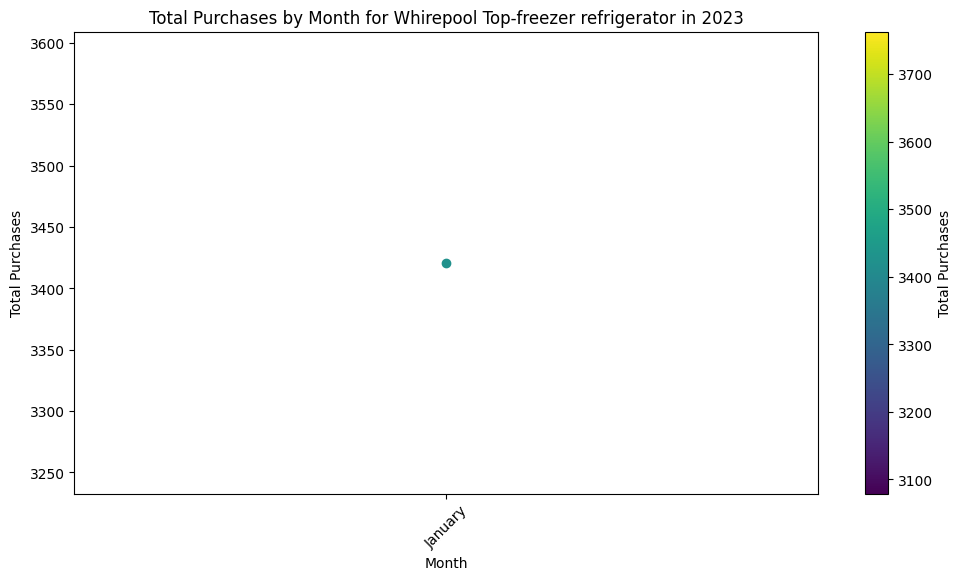

In [9]:
specific_year = 2023


filtered_year_df = grouped_df[grouped_df['Year'] == specific_year]


for product in filtered_year_df['products'].unique():

    product_df = filtered_year_df[filtered_year_df['products'] == product]

    plt.figure(figsize=(12, 6))
    plt.scatter(product_df['Month'], product_df['Total_Purchases'], c=product_df['Total_Purchases'], cmap='viridis')
    plt.xlabel('Month')
    plt.ylabel('Total Purchases')
    plt.title(f'Total Purchases by Month for {product} in {specific_year}')
    plt.colorbar(label='Total Purchases')
    plt.xticks(rotation=45)
    plt.show()

In [10]:
filtered_year_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5228 entries, 0 to 5227
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Year             5228 non-null   float64
 1   Month            5228 non-null   object 
 2   products         5228 non-null   object 
 3   Total_Purchases  5228 non-null   float64
dtypes: float64(2), object(2)
memory usage: 204.2+ KB
